In [1]:
import torch
from diffusers import I2VGenXLPipeline
from diffusers.utils import export_to_gif, load_image, export_to_video, make_image_grid
import os

pipeline = I2VGenXLPipeline.from_pretrained(
    "ali-vilab/i2vgen-xl", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_vae_slicing()
pipeline.enable_model_cpu_offload()

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


model_index.json:   0%|          | 0.00/555 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/601 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/507 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/588 [00:00<?, ?B/s]

image_encoder/config.json:   0%|          | 0.00/563 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.26G [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/706M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/705 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/627 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/637 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/2.84G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [2]:
def run_i2vgen(image, prompt, negative_prompt, output_name, seed=8888):
    frames = pipeline(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=image,
        num_inference_steps=50,
        guidance_scale=9.0,
        generator=torch.Generator("cpu").manual_seed(seed),
    ).frames[0]
    
    os.makedirs(os.path.dirname(output_name), exist_ok=True)
    # make_image_grid(frames[:16:4], rows=1, cols=4).save(output_name+"_frames.png")
    export_to_video(frames, output_name+".mp4")
    export_to_gif(frames, output_name+".gif")

In [3]:
image_url = (
    "https://huggingface.co/datasets/diffusers/docs-images/resolve/main/i2vgen_xl_images/img_0009.png"
)
image = load_image(image_url).convert("RGB")
prompt = "Papers were floating in the air on a table in the library"
negative_prompt = "Distorted, discontinuous, Ugly, blurry, low resolution, motionless, static, disfigured, disconnected limbs, Ugly faces, incomplete arms"
output_dir = "generated"

run_i2vgen(image, prompt, negative_prompt, output_dir+"/1")

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


  0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:605: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv3d(


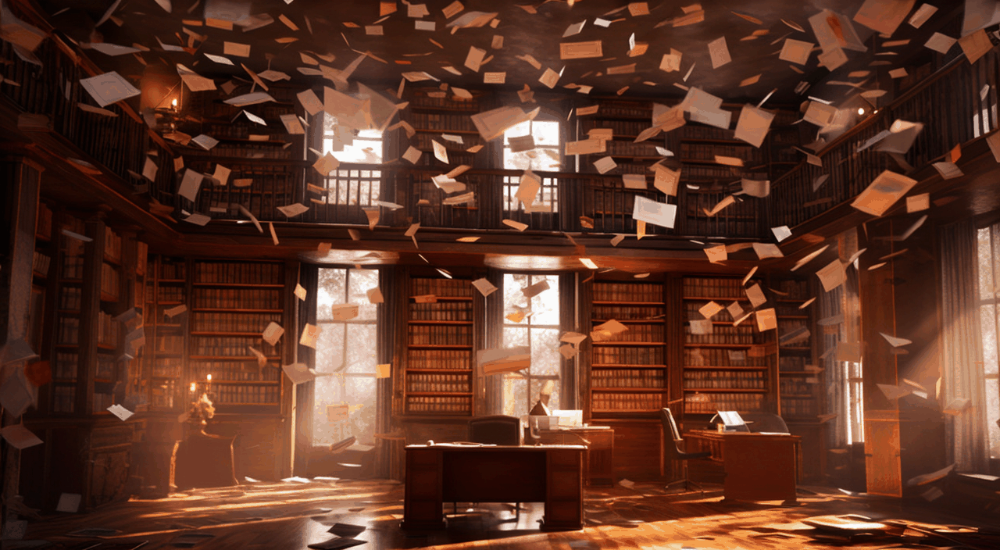

In [4]:
from IPython.display import Image

Image(output_dir+"/1.gif")

In [5]:
image = load_image("girl.jpg").convert("RGB").resize((1280, 850))
prompt = "A girl is smiling in front of a flower field, blurred background"

run_i2vgen(image, prompt, negative_prompt, output_dir+"/2")

  0%|          | 0/50 [00:00<?, ?it/s]

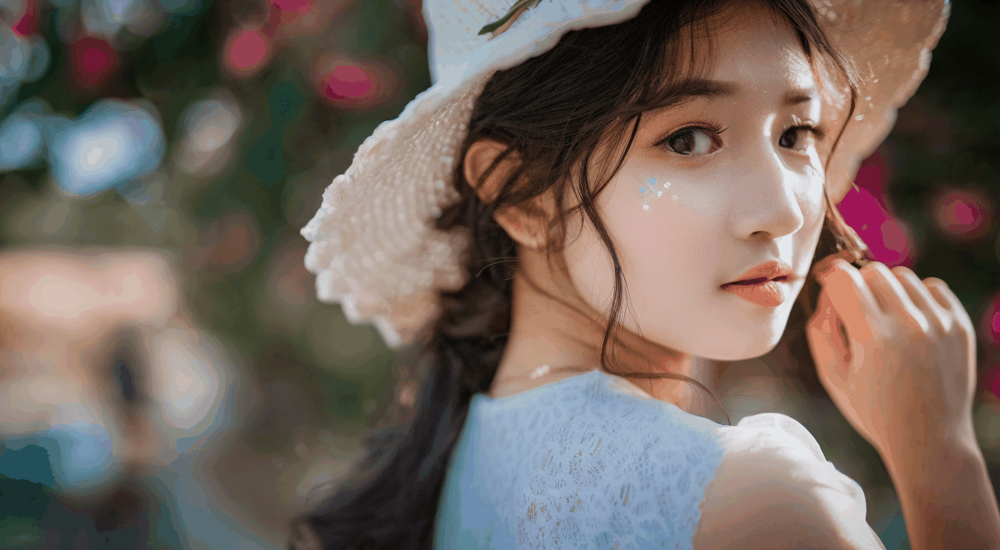

In [6]:
Image(output_dir+"/2.gif")

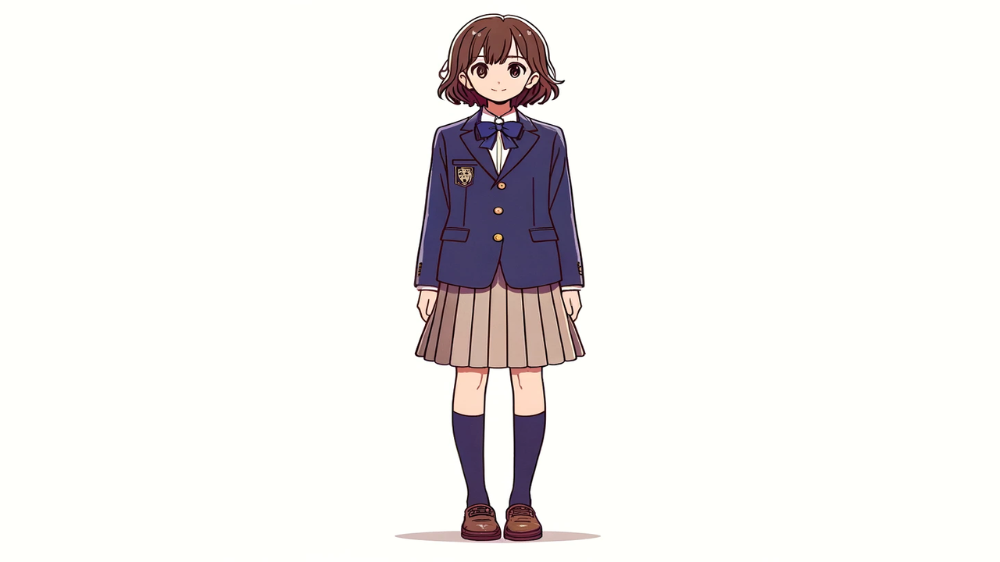

In [7]:
# アニメ画像
import PIL

image = load_image("anime_schoolgirl.png")
padding_color = image.getpixel((100, 100))

new_width = int((image.height / 720) * image.width)
pad_width = (new_width - image.width) // 2
padded_image = PIL.Image.new('RGB', (new_width, image.height), padding_color)
padded_image.paste(image, (pad_width, 0))

resized_image = padded_image.resize((1280, 720), PIL.Image.LANCZOS)
resized_image

In [8]:
prompt = "A school giri is dancing in a room, anime style"

run_i2vgen(resized_image, prompt, negative_prompt, output_dir+"/3")

  0%|          | 0/50 [00:00<?, ?it/s]

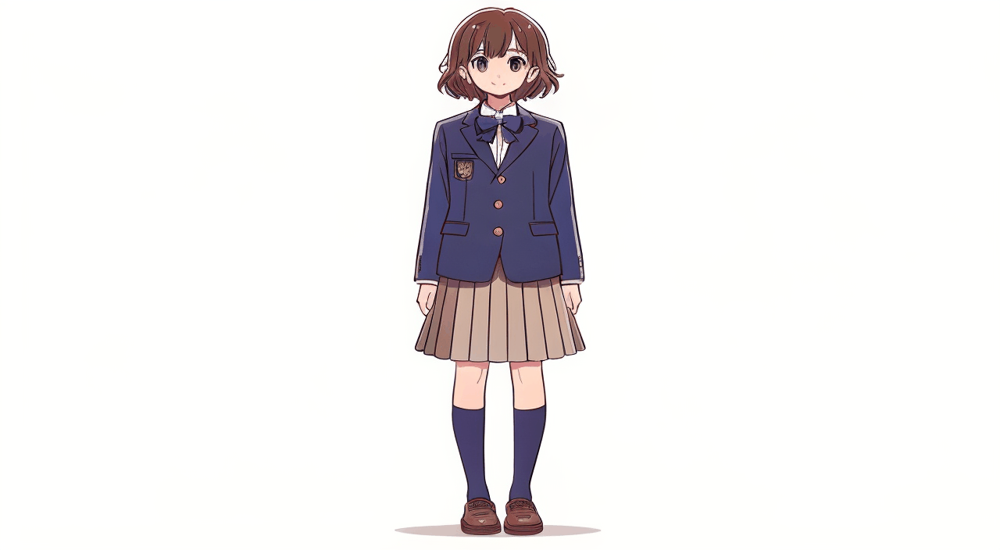

In [9]:
Image(output_dir+"/3.gif")

In [10]:
image = load_image("anime_magical_girl.png").convert("RGB").resize((1280, 720))
prompt = "A magical girl is waving a wand. Clothes are flowing and light is spinning around her."

run_i2vgen(image, prompt, negative_prompt, output_dir+"/4")

  0%|          | 0/50 [00:00<?, ?it/s]

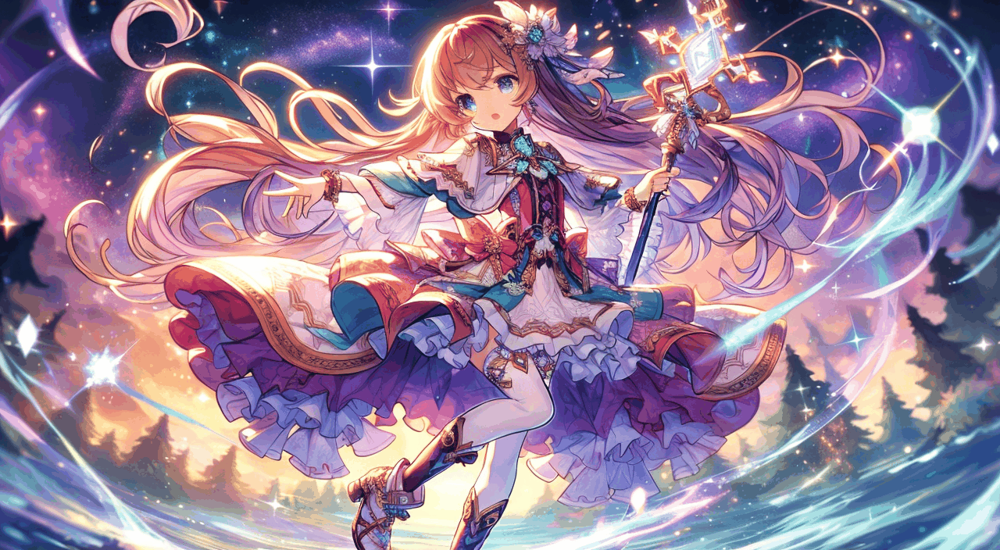

In [11]:
Image(output_dir+"/4.gif")

In [12]:
# 約16GB